In [1]:
import torch
import torch.nn

try:
    from ultralytics import YOLO
except:
    !pip install ultralytics
    from ultralytics import YOLO

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 660.1/660.1 kB 3.6 MB/s eta 0:00:00


In [2]:
# download the dataset
!curl -L "https://universe.roboflow.com/ds/rTSnBOdeq6?key=9TGU3dYlZ2" --output roboflow.zip; unzip roboflow.zip; rm roboflow.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   895  100   895    0     0   1352      0 --:--:-- --:--:-- --:--:--  1351
100 18.2M  100 18.2M    0     0  15.9M      0  0:00:01  0:00:01 --:--:--  248M
Archive:  roboflow.zip
 extracting: README.dataset.txt      
 extracting: README.roboflow.txt     
 extracting: data.yaml               
   creating: test/
   creating: test/images/
 extracting: test/images/20231009_132947_jpg.rf.3efbc254f393279eb709d352589d53a8.jpg  
 extracting: test/images/20231009_133003_jpg.rf.79f86c266a1b904fce294d14d223e36f.jpg  
 extracting: test/images/20231009_133120_jpg.rf.255f7f397f36df359c772dd179408820.jpg  
 extracting: test/images/20231009_133211_jpg.rf.2eb1b58436b0e9025a624ff2eaf61c3a.jpg  
 extracting: test/images/20231009_133237_jpg.rf.8bae0bd7a957a5b571e3a7130f0f1ce7.jpg  
 extracting: test/images/20231009_133300_jpg.rf.693e46d5198ae3b8dfc

In [3]:
yolo = YOLO('yolov5n.pt')

PRO TIP 💡 Replace 'model=yolov5n.pt' with new 'model=yolov5nu.pt'.
YOLOv5 'u' models are trained with https://github.com/ultralytics/ultralytics and feature improved performance vs standard YOLOv5 models trained with https://github.com/ultralytics/yolov5.



100%|██████████| 5.27M/5.27M [00:00<00:00, 70.0MB/s]


In [4]:
yolo.train(data="./data.yaml", epochs=40)

Ultralytics YOLOv8.0.225 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov5n.pt, data=./data.yaml, epochs=40, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, line_width=None, format=torchscript, keras=Fa

100%|██████████| 755k/755k [00:00<00:00, 15.5MB/s]


Overriding model.yaml nc=80 with nc=5

                   from  n    params  module                                       arguments                     
  0                  -1  1      1760  ultralytics.nn.modules.conv.Conv             [3, 16, 6, 2, 2]              
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      4800  ultralytics.nn.modules.block.C3              [32, 32, 1]                   
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     29184  ultralytics.nn.modules.block.C3              [64, 64, 2]                   
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  3    156928  ultralytics.nn.modules.block.C3              [128, 128, 3]                 
  7                  -1  1    295424  ultralytics

100%|██████████| 6.23M/6.23M [00:00<00:00, 75.7MB/s]


AMP: checks passed ✅


train: Scanning /content/train/labels... 382 images, 0 backgrounds, 0 corrupt: 100%|██████████| 382/382 [00:00<00:00, 1894.63it/s]

train: New cache created: /content/train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/valid/labels... 37 images, 1 backgrounds, 0 corrupt: 100%|██████████| 37/37 [00:00<00:00, 860.15it/s]

val: New cache created: /content/valid/labels.cache


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001111, momentum=0.9) with parameter groups 69 weight(decay=0.0), 76 weight(decay=0.0005), 75 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 40 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/40      3.27G      1.598      3.798      1.082        429        640: 100%|██████████| 24/24 [00:22<00:00,  1.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.10it/s]

                   all         37       1078     0.0381       0.38      0.108     0.0542



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/40      2.97G      1.582       2.61      1.013        413        640: 100%|██████████| 24/24 [00:10<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.86it/s]

                   all         37       1078      0.212      0.374      0.259      0.137



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/40      2.91G      1.487      2.036     0.9952        620        640: 100%|██████████| 24/24 [00:08<00:00,  2.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.46it/s]

                   all         37       1078      0.281      0.389      0.351      0.214



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/40      3.18G      1.467      1.796     0.9865        575        640: 100%|██████████| 24/24 [00:09<00:00,  2.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.46it/s]

                   all         37       1078      0.349      0.512      0.429      0.227



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/40      3.41G       1.46      1.633     0.9898        773        640: 100%|██████████| 24/24 [00:10<00:00,  2.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.40it/s]

                   all         37       1078      0.494      0.531      0.475      0.287



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/40      3.28G      1.432      1.581          1        292        640: 100%|██████████| 24/24 [00:12<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.43it/s]

                   all         37       1078      0.554      0.494      0.491      0.288



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/40      2.95G      1.377      1.453     0.9794        561        640: 100%|██████████| 24/24 [00:11<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.68it/s]

                   all         37       1078      0.693      0.491      0.563      0.365



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/40      2.78G      1.353      1.389     0.9778        438        640: 100%|██████████| 24/24 [00:11<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.00it/s]

                   all         37       1078      0.547      0.527      0.571      0.371



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/40      3.04G      1.355      1.349     0.9755        587        640: 100%|██████████| 24/24 [00:10<00:00,  2.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.26it/s]


                   all         37       1078      0.607       0.53      0.593      0.384

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/40      3.52G      1.325       1.29     0.9662        694        640: 100%|██████████| 24/24 [00:13<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.23it/s]

                   all         37       1078      0.615      0.537       0.59       0.39



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/40      3.28G      1.319      1.232     0.9645        585        640: 100%|██████████| 24/24 [00:10<00:00,  2.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.86it/s]

                   all         37       1078      0.668       0.56      0.624       0.39



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/40      3.22G      1.303      1.233     0.9693        603        640: 100%|██████████| 24/24 [00:08<00:00,  2.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.57it/s]

                   all         37       1078      0.613      0.581      0.628       0.41



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/40      3.19G      1.258      1.175     0.9544        457        640: 100%|██████████| 24/24 [00:09<00:00,  2.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.33it/s]


                   all         37       1078      0.675      0.542      0.616      0.387

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/40       3.1G      1.284      1.161     0.9617        426        640: 100%|██████████| 24/24 [00:10<00:00,  2.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.70it/s]

                   all         37       1078      0.713      0.599      0.681      0.431



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/40       3.3G      1.261      1.119     0.9628        437        640: 100%|██████████| 24/24 [00:10<00:00,  2.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.26it/s]

                   all         37       1078      0.694      0.645      0.676      0.422



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/40      3.32G      1.267      1.097      0.958        488        640: 100%|██████████| 24/24 [00:10<00:00,  2.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.01it/s]

                   all         37       1078      0.661      0.595      0.643      0.401



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/40      3.12G       1.24      1.088     0.9536        352        640: 100%|██████████| 24/24 [00:08<00:00,  2.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.49it/s]

                   all         37       1078      0.693      0.677      0.722      0.462



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/40      2.86G      1.261      1.064     0.9578        614        640: 100%|██████████| 24/24 [00:09<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.52it/s]


                   all         37       1078      0.748      0.688      0.741      0.475

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/40      2.89G       1.24      1.026     0.9512        465        640: 100%|██████████| 24/24 [00:10<00:00,  2.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.29it/s]

                   all         37       1078      0.785      0.664      0.739      0.469



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/40      3.12G      1.226      1.004     0.9459        516        640: 100%|██████████| 24/24 [00:11<00:00,  2.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.72it/s]


                   all         37       1078      0.758      0.684      0.727      0.455

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/40      3.57G       1.26     0.9853      0.952        468        640: 100%|██████████| 24/24 [00:10<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.93it/s]

                   all         37       1078       0.75      0.684      0.737      0.484



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/40       3.8G      1.238     0.9708     0.9436        587        640: 100%|██████████| 24/24 [00:09<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.50it/s]

                   all         37       1078      0.814      0.675      0.748      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/40       3.1G       1.24     0.9523     0.9577        547        640: 100%|██████████| 24/24 [00:09<00:00,  2.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.49it/s]

                   all         37       1078      0.788      0.698      0.753      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/40      3.35G      1.212     0.9414      0.952        439        640: 100%|██████████| 24/24 [00:10<00:00,  2.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.22it/s]

                   all         37       1078       0.82      0.677      0.759      0.491



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/40      3.12G      1.181     0.9148     0.9382        655        640: 100%|██████████| 24/24 [00:10<00:00,  2.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.51it/s]

                   all         37       1078      0.782      0.667      0.744      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/40      3.14G      1.196     0.9135     0.9437        583        640: 100%|██████████| 24/24 [00:10<00:00,  2.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.31it/s]

                   all         37       1078      0.792      0.693      0.749      0.489



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/40      2.99G      1.173     0.8865     0.9423        503        640: 100%|██████████| 24/24 [00:08<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.57it/s]

                   all         37       1078      0.824      0.707      0.768      0.509



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/40      2.92G      1.181     0.8854     0.9346        674        640: 100%|██████████| 24/24 [00:09<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.43it/s]

                   all         37       1078      0.723      0.664      0.731      0.477



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/40      3.05G       1.16     0.8802     0.9378        362        640: 100%|██████████| 24/24 [00:10<00:00,  2.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.98it/s]

                   all         37       1078      0.815      0.715      0.781      0.525



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/40      3.52G      1.181     0.8587     0.9371        656        640: 100%|██████████| 24/24 [00:10<00:00,  2.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.39it/s]

                   all         37       1078      0.788      0.714      0.782      0.509


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/40      3.06G      1.169     0.8652     0.9401        352        640: 100%|██████████| 24/24 [00:16<00:00,  1.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.37it/s]

                   all         37       1078      0.781        0.7      0.772      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/40      2.73G      1.181      0.837     0.9462        324        640: 100%|██████████| 24/24 [00:09<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.32it/s]

                   all         37       1078      0.751      0.692      0.758      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/40      2.87G      1.171       0.83     0.9378        335        640: 100%|██████████| 24/24 [00:08<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.78it/s]

                   all         37       1078      0.804      0.691      0.774      0.499



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/40      2.58G      1.174     0.8052      0.945        409        640: 100%|██████████| 24/24 [00:07<00:00,  3.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.23it/s]

                   all         37       1078      0.795      0.699       0.77      0.509



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/40      2.78G      1.162     0.8012     0.9415        370        640: 100%|██████████| 24/24 [00:09<00:00,  2.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.48it/s]


                   all         37       1078      0.795      0.732      0.777      0.515

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/40      3.18G      1.149     0.7813     0.9375        385        640: 100%|██████████| 24/24 [00:09<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.35it/s]


                   all         37       1078      0.769       0.76      0.787      0.522

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/40      2.77G       1.15     0.7747     0.9422        407        640: 100%|██████████| 24/24 [00:07<00:00,  3.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.33it/s]

                   all         37       1078      0.789      0.743      0.772      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/40      3.09G      1.127     0.7706     0.9365        398        640: 100%|██████████| 24/24 [00:09<00:00,  2.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.71it/s]

                   all         37       1078      0.779      0.749      0.785      0.524



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/40      2.54G      1.137     0.7711     0.9338        356        640: 100%|██████████| 24/24 [00:09<00:00,  2.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.73it/s]

                   all         37       1078      0.801       0.73      0.779      0.505



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/40      2.86G      1.123     0.7581     0.9342        390        640: 100%|██████████| 24/24 [00:07<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.64it/s]

                   all         37       1078      0.803      0.746      0.782       0.52



40 epochs completed in 0.140 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 5.3MB
Optimizer stripped from runs/detect/train/weights/best.pt, 5.3MB

Validating runs/detect/train/weights/best.pt...
Ultralytics YOLOv8.0.225 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
YOLOv5n summary (fused): 193 layers, 2503919 parameters, 0 gradients, 7.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.84it/s]


                   all         37       1078      0.814      0.719      0.781      0.526
                 Crimp         37        377      0.734      0.777      0.791      0.513
                   Jug         37        284      0.875      0.792       0.88      0.615
                 Pinch         37        145      0.806       0.63      0.672      0.395
                Pocket         37         46      0.896      0.745      0.791      0.528
                Sloper         37        226      0.759       0.65      0.768      0.579
Speed: 0.3ms preprocess, 3.5ms inference, 0.0ms loss, 3.8ms postprocess per image
Results saved to runs/detect/train


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7bc2c0054fa0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [25]:
from PIL import Image


image 1/1 /content/test/images/20231016_174531_jpg.rf.9d1c944ca270dc8c1cd248aa0b2befaa.jpg: 640x640 12 Crimps, 5 Jugs, 3 Pinchs, 4 Slopers, 10.5ms
Speed: 1.8ms preprocess, 10.5ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


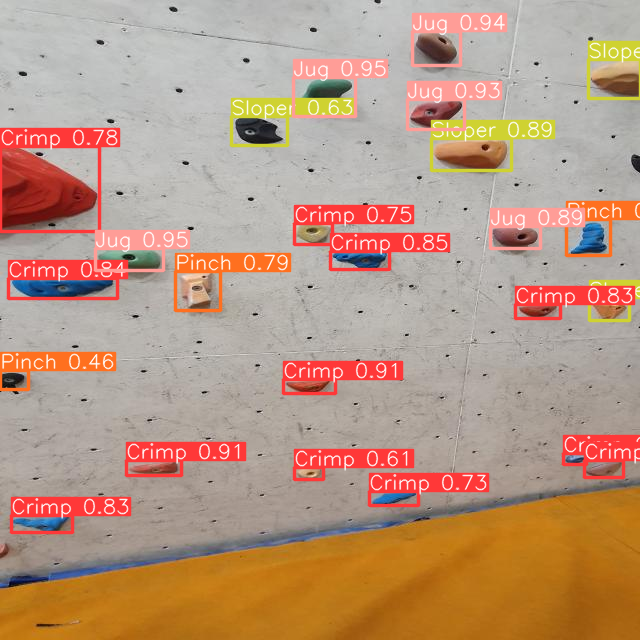

In [5]:
from PIL import Image
def run_yolo(yolo, image_url, conf=0.25, iou=0.7):
    results = yolo(image_url, conf=conf, iou=iou)
    res = results[0].plot()[:, :, [2,1,0]]
    return Image.fromarray(res)

yolo = YOLO('./runs/detect/train/weights/best.pt')

image_url = './test/images/20231016_174531_jpg.rf.9d1c944ca270dc8c1cd248aa0b2befaa.jpg'

run_yolo(yolo, image_url)

In [10]:
import zipfile
import os
#manually downloaded the zipfile from roboflow


zip_file_path = 'yolo5.zip'


extracted_dir = 'test_data'

os.makedirs(extracted_dir, exist_ok=True)

In [11]:
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(extracted_dir)

In [21]:
path="./test_data/test/images"


image 1/1 /content/test_data/test/images/IMG_2776_jpg.rf.638fea272ef2775c03befba97ecda95f.jpg: 480x640 93 Pockets, 3 Slopers, 9.8ms
Speed: 3.3ms preprocess, 9.8ms inference, 2.1ms postprocess per image at shape (1, 3, 480, 640)


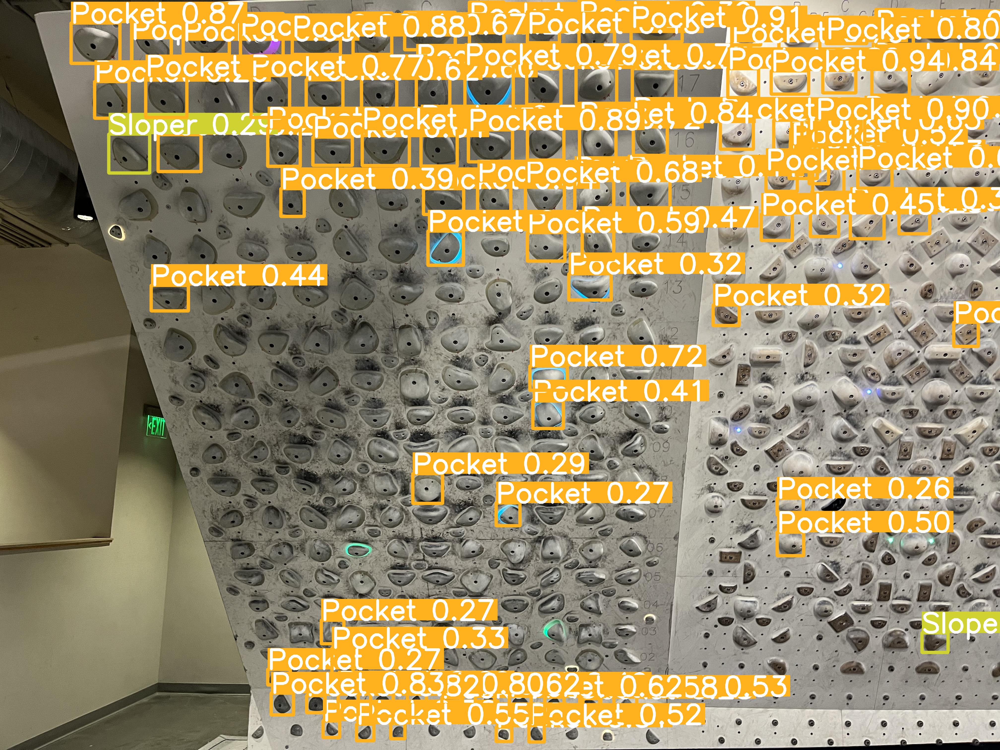


image 1/1 /content/test_data/test/images/IMG_2774_jpg.rf.3d6572e3e920a6810f1126ccb0b86b87.jpg: 480x640 2 Crimps, 1 Jug, 1 Pinch, 78 Pockets, 10 Slopers, 21.4ms
Speed: 4.4ms preprocess, 21.4ms inference, 2.8ms postprocess per image at shape (1, 3, 480, 640)


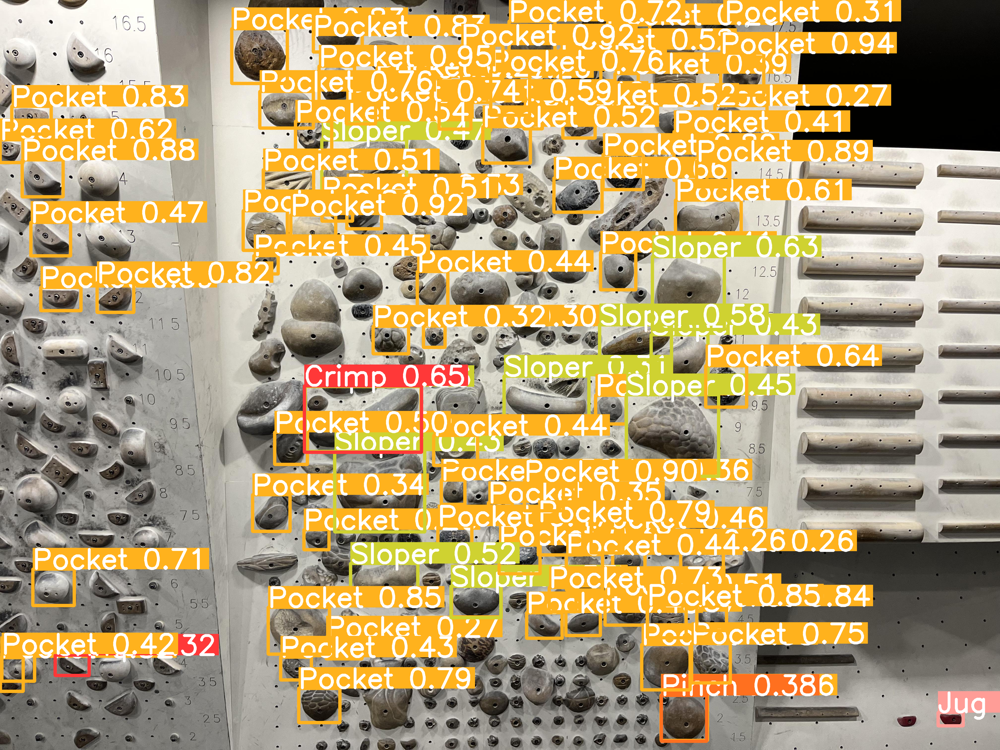


image 1/1 /content/test_data/test/images/IMG_2771_jpg.rf.8c802e3e31dcd50da2c599027c0c3475.jpg: 480x640 3 Crimps, 1 Jug, 4 Pockets, 17 Slopers, 11.3ms
Speed: 4.0ms preprocess, 11.3ms inference, 2.6ms postprocess per image at shape (1, 3, 480, 640)


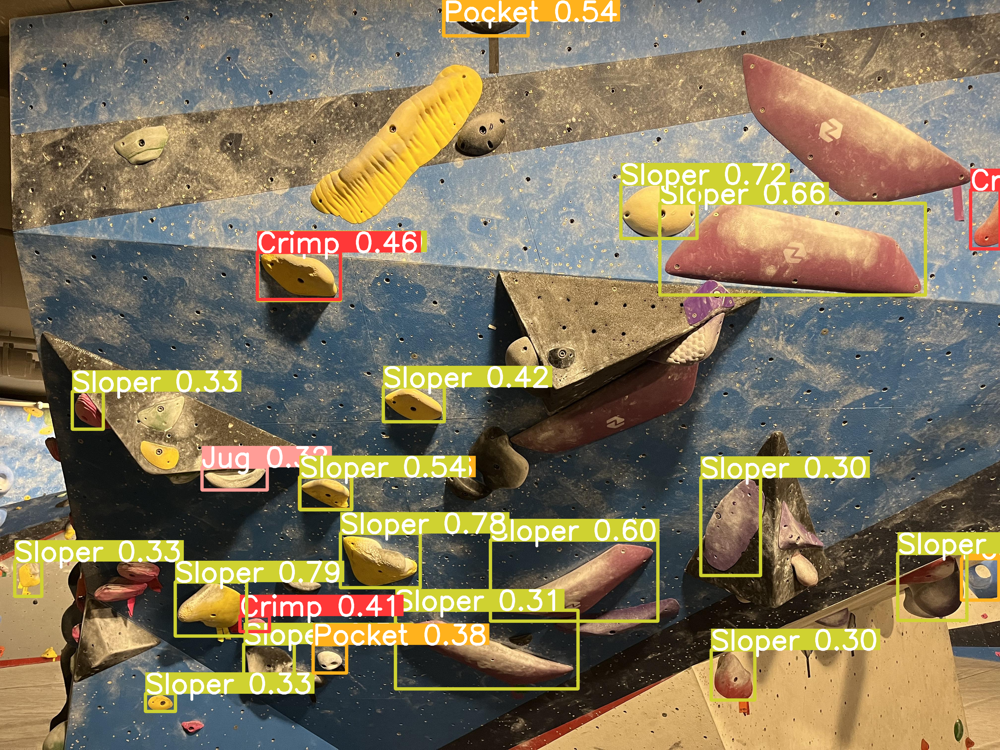

In [27]:
from IPython.display import Image as img, display

for item in os.listdir(path):
    picture = path + "/" + item
    results = yolo(picture, conf=0.25, iou=0.7)
    res = results[0].plot()[:, :, [2,1,0]]
    display(Image.fromarray(res))

In [28]:
# %load_ext tensorboard
# %tensorboard --logdir runs